In [1]:
%matplotlib notebook 

import numpy as np

import matplotlib.ticker
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.patches import Rectangle # xy, width, height

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import sunpy.map
import sunpy.data.sample
from sunpy.net import Fido, attrs as a
from sunpy.coordinates import Helioprojective, RotatedSunFrame, transform_with_sun_center
from sunpy.map.maputils import all_coordinates_from_map, coordinate_is_on_solar_disk
from sunpy.io import write_file
from sunpy.time import parse_time

import astropy.units as u
from astropy.coordinates import SkyCoord, ICRS
from astropy.wcs import WCS
from astropy.wcs.utils import skycoord_to_pixel
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits

from reproject import reproject_interp
from aiapy.calibrate import register, update_pointing
from aiapy.calibrate.util import get_pointing_table
from scipy.io import loadmat
from scipy import ndimage
import os, sys
import copy
from PIL import Image
import datetime
import math
from math import sin, cos, asin, acos, atan, sqrt
import pandas as pd
  
import cv2

%run ./functions.ipynb

The analysis of the 3x3 box is carried out by means of the sum and the average value of every pixel intensity. In both cases, the value for the whole box is computed and compared with the value of the only-dimming pixels.

### Event choice

In [2]:
# event= 'E:/DATA/POLIMI/THESIS/.fits_files/Final-3_days/Event-2012-03-07'
event = "F:/DATA/POLIMI/THESIS/.fits_files/NEW_diffrot/Event-2012-03-07/"
event_time='March 07 2012'
flare_time='2012-03-07 00:24:00.630'
peak= pd.to_datetime('2012-03-07T00:24:00.630')

In [5]:
## Load the images

## Original differentially rotated image
Diffrot_img = sunpy.map.Map(event+'/DiffRot/DiffRot crop/*.fits',
                            sequence=True)
# Diffrot_img[0].plot(vmax=1000)
# plt.colorbar()

## BD cropped images
BD_img = sunpy.map.Map(event+'/BD/BD crop/*.fits',
                       sequence=True)
# BD_img[0].plot(vmin=-7, vmax=7)
# cbar=colorbar([-7, 7], 1)


## LBR cropped images
LBR_img = sunpy.map.Map(event+'/LBR/LBR crop/*.fits',
                        sequence=True)
print('Length of LBR images: ', len(LBR_img))

## segmented cropped images
seg_img = sunpy.map.Map(event+'/Segmented_Binary/*.fits',
                        sequence=True)
print('Length of segmented images: ', len(seg_img))

Length of LBR images:  350
Length of segmented images:  255


## Box choice 
The choice of the pixels boxes is carried out manually, after inspection of the event evolution, using both the LBR and the segmented images

181853.0
28
length of seeds array:  2278


<IPython.core.display.Javascript object>


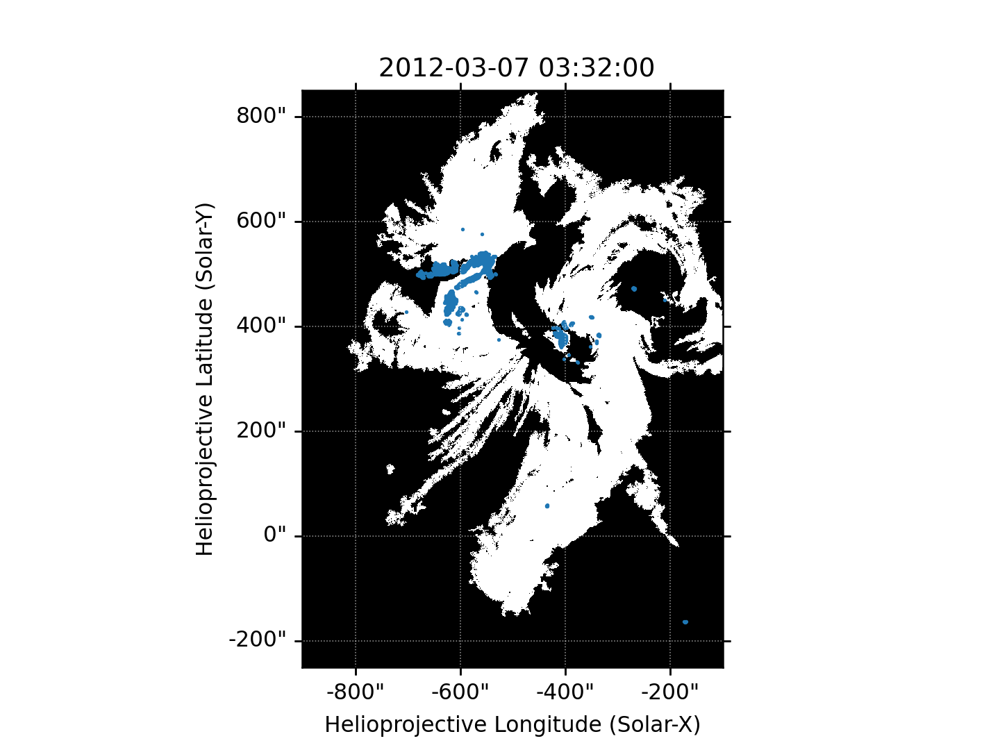

In [9]:
dim_pix=[] ## list where to put the number of dimming pixels of each map in the sequence
for i in range(30):
    # in the segmented map, dimming pixels = 255
    num= sum(seg_img[i].data[seg_img[i].data==255])/255
    dim_pix.append(num)

# print(dim_pix)
dim_ext=np.array(dim_pix)
larg= int(np.argwhere(dim_ext==np.amax(dim_ext)))
print(np.amax(dim_ext))
print(larg)

seeds_list=find_seeds_LBR(LBR_img[7].data, perc= 0.05)   # default values: threshold=-0.19, percentage=0.3
seeds = np.array(seeds_list)
row=[val[0] for val in seeds]
col=[val[1] for val in seeds]
print('length of seeds array: ', len(col))

fixed= seg_img[larg]

plt.figure()
fixed.plot()
plt.scatter(col, row, s=0.5)
# fixed.peek()
# plt.colorbar

In [5]:
## Manually choose the points where to crop the image in order to follow the behaviour over time
## box = [x coord, y coord] = [column, row]
# Area 1 : bottom left
# box1=[150,245] # area1 : bottom left
# box2=[140,250]

# area1
box1=[235,600] 
box2=[230,550]
box3=[260,600]
box4=[290,560]
# area2
box5=[300,680] 
box6=[300,740] 
box7=[260,750]
# area3
box8=[415,510] 
box9=[440,550]
box10=[480,410]
box11=[480,550]
box12=[485,470]
# area4 : bottom right
box13=[360,200] 
box14=[380,230]


box= [box1, box2, box3, box4, box5, box6, box7,
       box8, box9, box10, box11, box12, box13,box14]
color_box=['lime','royalblue','orange','fuchsia','yellow','pink','coral',
           'cyan','peru','deepskyblue','tomato','gold','yellowgreen','deeppink']
color_dash=['darkgreen','darkblue','saddlebrown','darkmagenta','olive','palevioletred','brown',
           'darkslategray','saddlebrown','steelblue','crimson','darkgoldenrod','darkgreen','darkmagenta']

area1=[box1,box2,box3,box4]
area2=[box5,box6,box7]
area3=[box8,box9,box10,box11,box12]
area4=[box13,box14]

### Pixel box location
To ensure that the box is still within the dimming region (if needed) we can compare an image at the beginning of the dataset and one closer to the end of the dataset

<IPython.core.display.Javascript object>


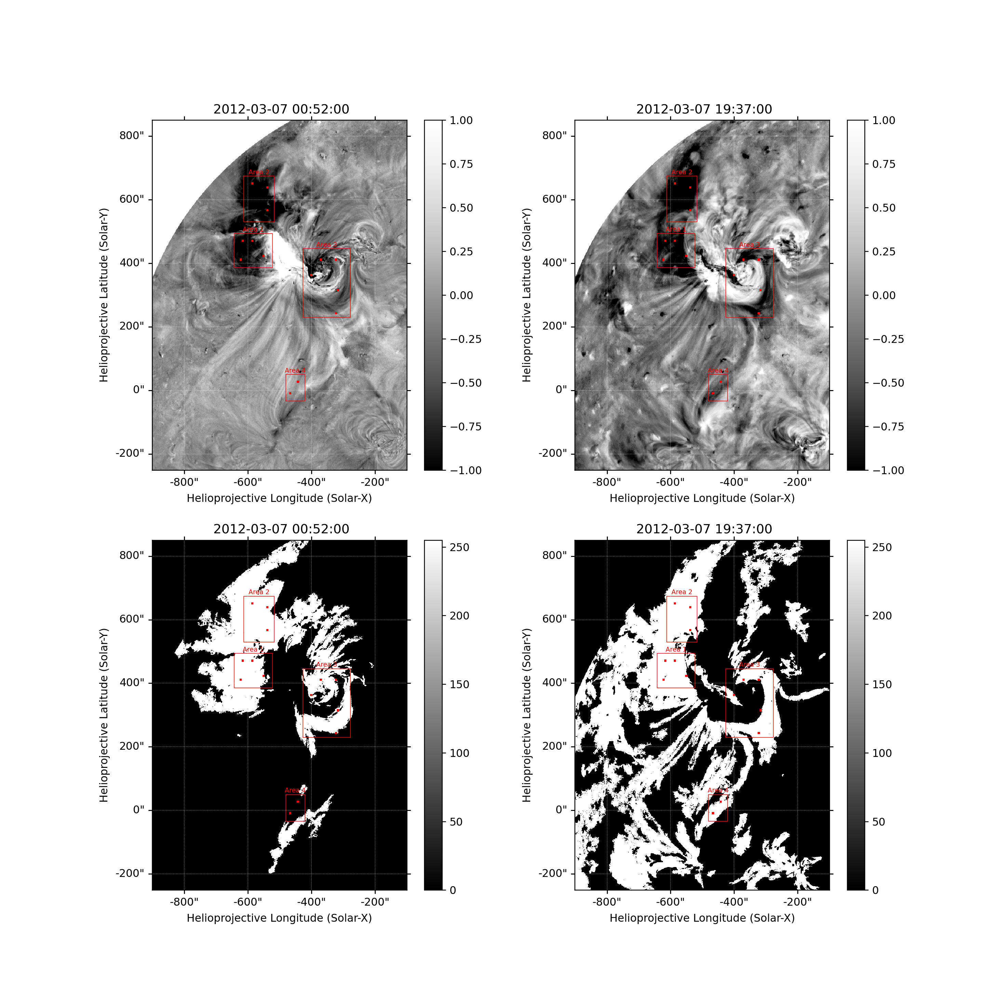

In [11]:
img1= 10
img2= 220

fig= plt.figure(figsize=(13,13))
ax1 = fig.add_subplot(2,2,1, projection= LBR_img[img1])
LBR_img[img1].plot(vmin=-1, vmax=1, cmap='Greys_r')
plt.colorbar()
for box_el in box:
    make_pixel_rect(box_el, 3, ax1)
ax=ax1
surrounding_rect((215, 530), 100, 90, ax, 'Area 1', position='top')
surrounding_rect((240, 650), 80, 120, ax, 'Area 2', position='top')
surrounding_rect((395, 400), 125, 180, ax, 'Area 3', position='top')
surrounding_rect((350, 180), 50, 70, ax, 'Area 4', position='top')

ax2 = fig.add_subplot(2,2,2, projection= LBR_img[img2])
LBR_img[img2].plot(vmin=-1, vmax=1, cmap='Greys_r')
plt.colorbar()
for box_el in box:
    make_pixel_rect(box_el, 3, ax2)
ax=ax2
surrounding_rect((215, 530), 100, 90, ax, 'Area 1', position='top')
surrounding_rect((240, 650), 80, 120, ax, 'Area 2', position='top')
surrounding_rect((395, 400), 125, 180, ax, 'Area 3', position='top')
surrounding_rect((350, 180), 50, 70, ax, 'Area 4', position='top')

ax3 = fig.add_subplot(2,2,3, projection= seg_img[img1])
seg_img[img1].plot()
plt.colorbar()
for box_el in box:
    make_pixel_rect(box_el, 3, ax3)
ax=ax3
surrounding_rect((215, 530), 100, 90, ax, 'Area 1', position='top')
surrounding_rect((240, 650), 80, 120, ax, 'Area 2', position='top')
surrounding_rect((395, 400), 125, 180, ax, 'Area 3', position='top')
surrounding_rect((350, 180), 50, 70, ax, 'Area 4', position='top')

ax4 = fig.add_subplot(2,2,4, projection= seg_img[img2])
seg_img[img2].plot()
plt.colorbar()
for box_el in box:
    make_pixel_rect(box_el, 3, ax4)
ax=ax4
surrounding_rect((215, 530), 100, 90, ax, 'Area 1', position='top')
surrounding_rect((240, 650), 80, 120, ax, 'Area 2', position='top')
surrounding_rect((395, 400), 125, 180, ax, 'Area 3', position='top')
surrounding_rect((350, 180), 50, 70, ax, 'Area 4', position='top')


plt.savefig(event+'/images/Box_choice.png')

<IPython.core.display.Javascript object>


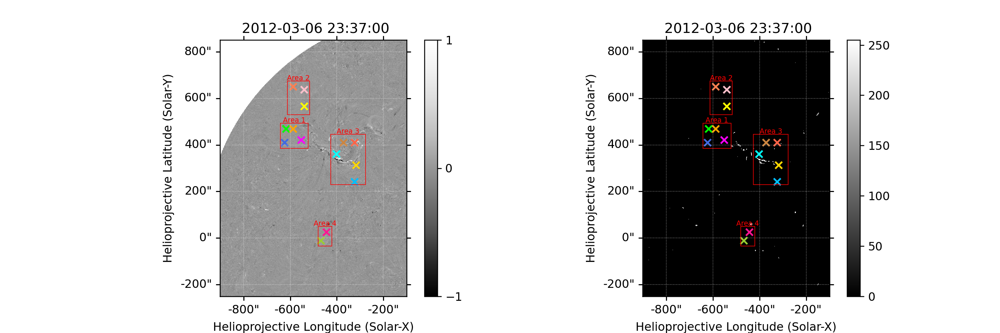

<IPython.core.display.Javascript object>


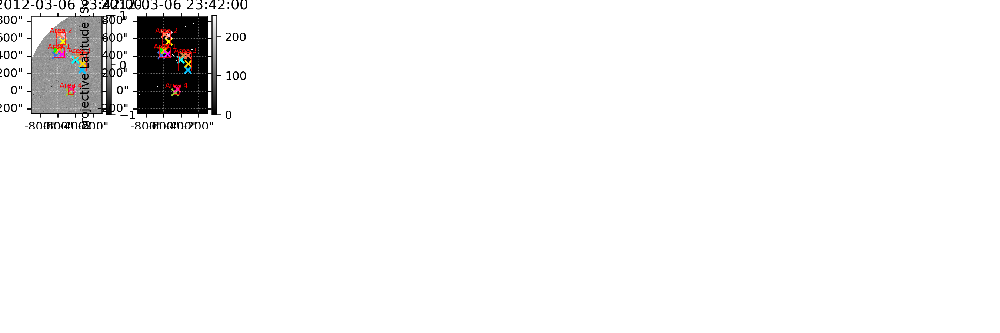

<IPython.core.display.Javascript object>


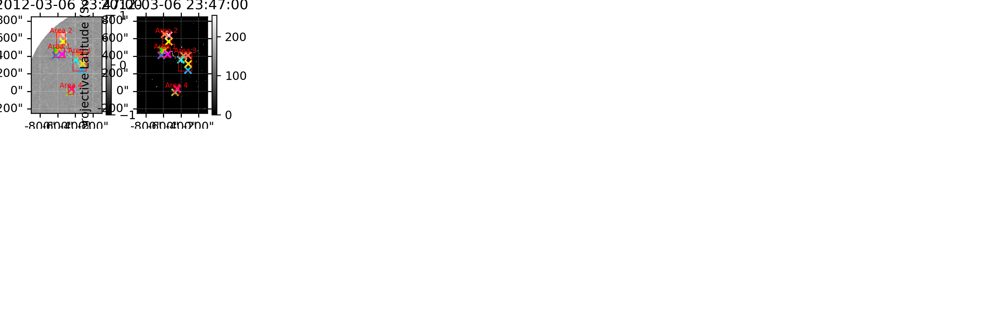

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


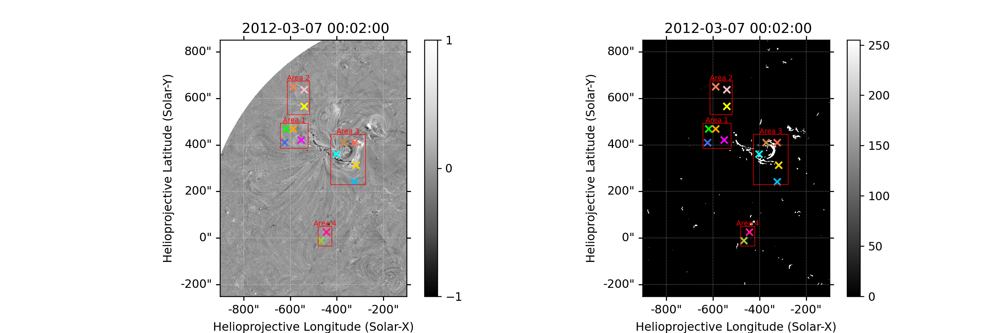

<IPython.core.display.Javascript object>


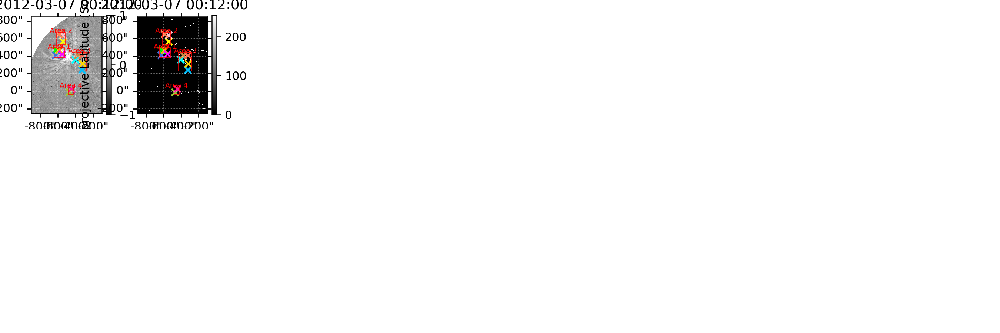

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


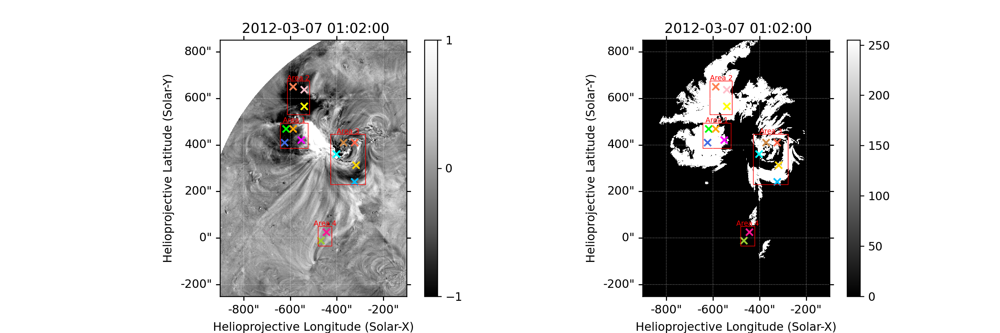

<IPython.core.display.Javascript object>


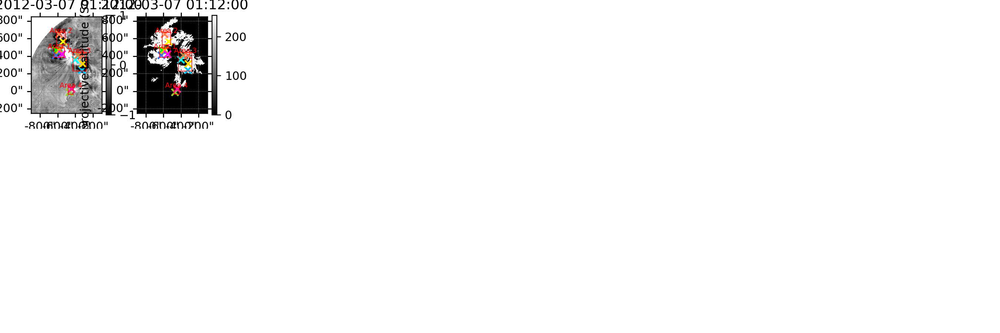

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


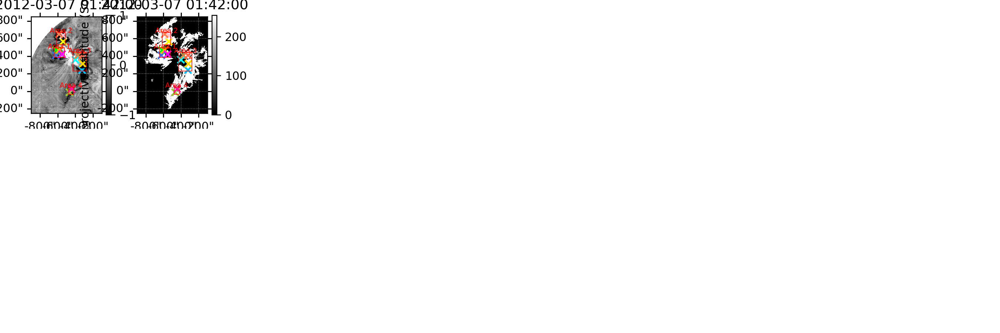

<IPython.core.display.Javascript object>


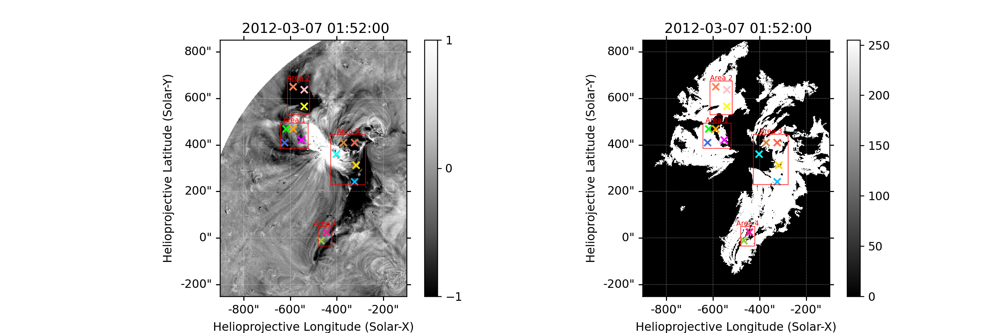

<IPython.core.display.Javascript object>


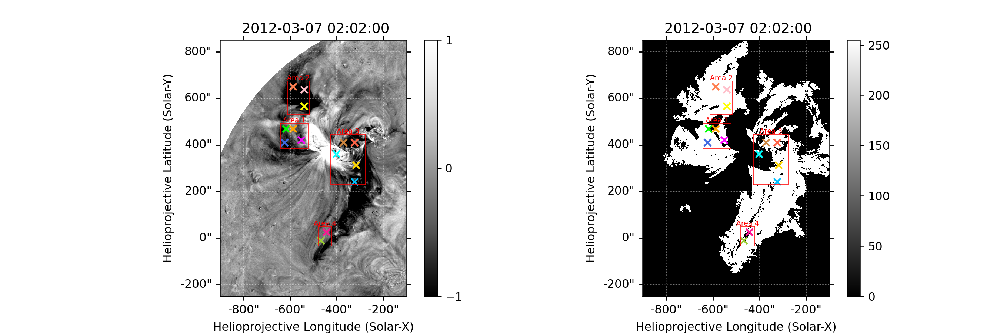

C:\Users\Giulia\AppData\Local\Temp\ipykernel_41108\2131446340.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig= plt.figure(figsize=(12,4))


<IPython.core.display.Javascript object>


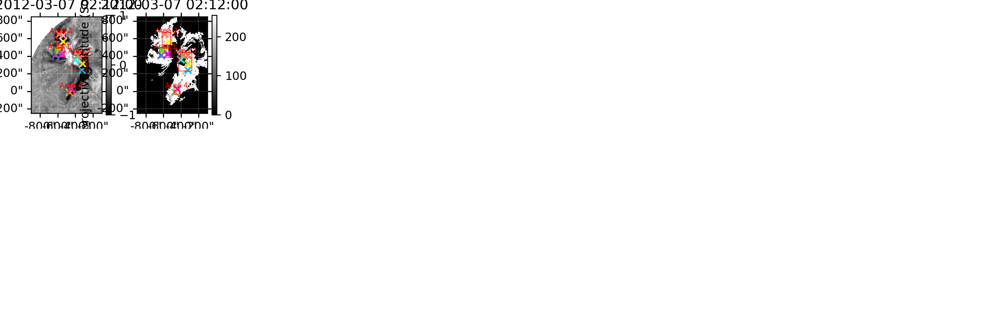

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


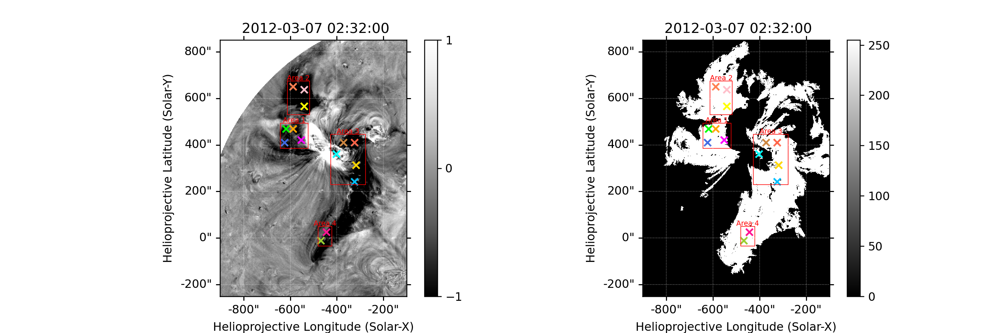

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


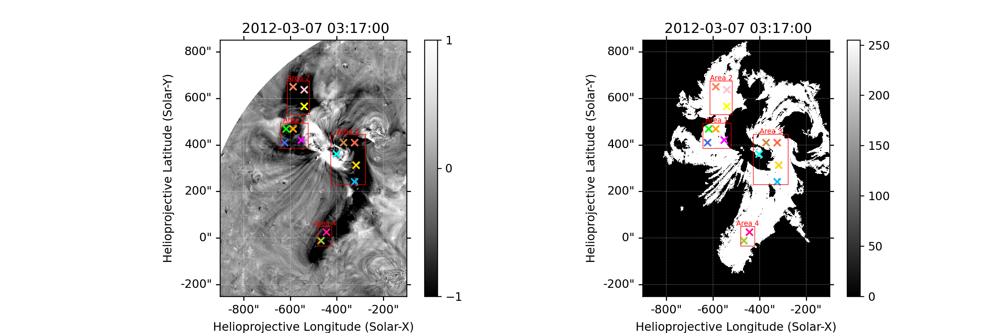

<IPython.core.display.Javascript object>


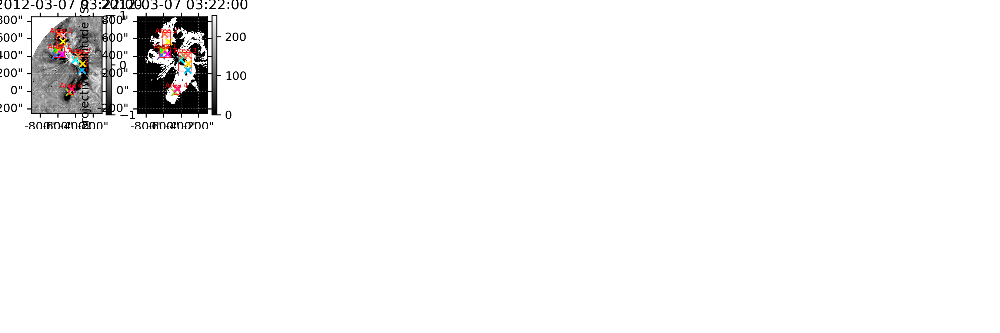

<IPython.core.display.Javascript object>


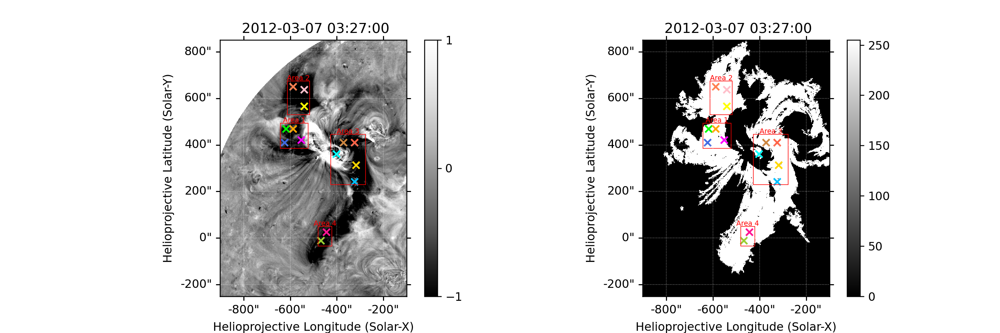

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


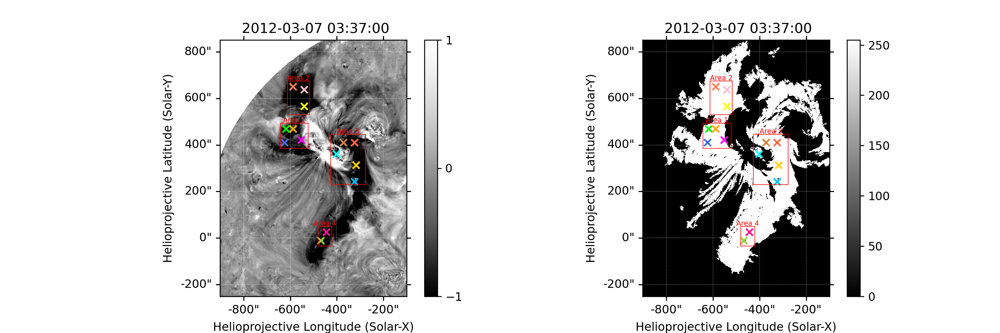

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


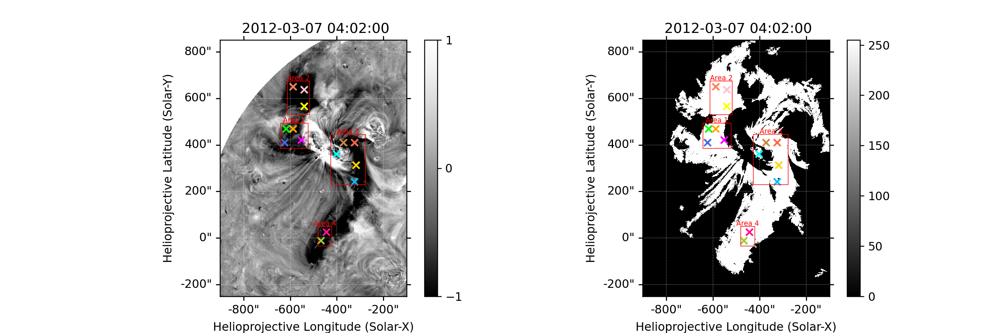

<IPython.core.display.Javascript object>


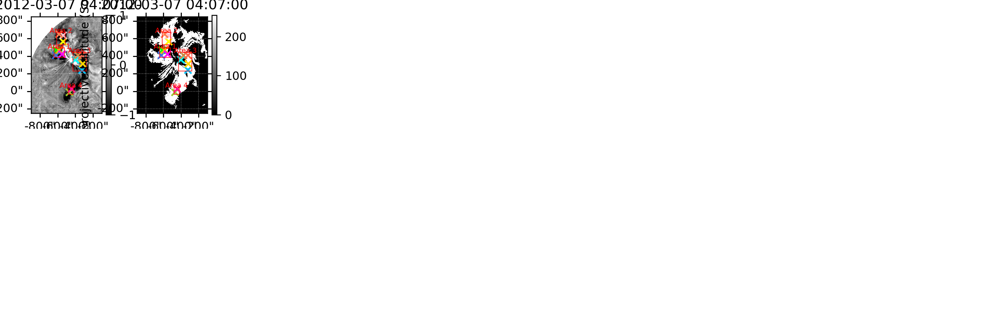

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


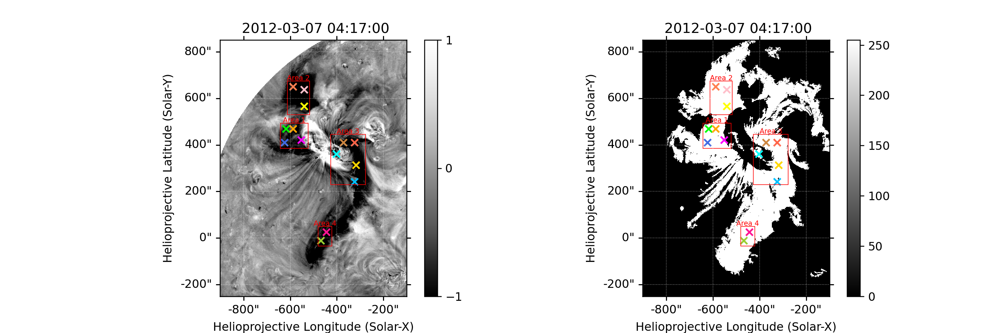

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [12]:
# for i in range(len(BD_img)):
for i in range(300):
    fig= plt.figure(figsize=(12,4))
    ax1 = fig.add_subplot(1,2,1, projection= LBR_img[i])
    LBR_img[i].plot(vmin=-1, vmax=1, cmap='Greys_r')
    colorbar([-1,1], 1)
#     make_pixel_rect(box1, 3, ax1)
#     make_pixel_rect(box2, 3, ax1)
#     make_pixel_rect(box3, 3, ax1)
    for k in range(len(box)):
        box_el= box[k]
        plt.scatter(box_el[0],box_el[1], marker='x', color=color_box[k])
#     plt.scatter(box1[0],box1[1], marker='x')
#     plt.scatter(box2[0],box2[1], marker='x')
#     plt.scatter(box3[0],box3[1], marker='x')
    ax=ax1
    surrounding_rect((215, 530), 100, 90, ax, 'Area 1', position='top')
    surrounding_rect((240, 650), 80, 120, ax, 'Area 2', position='top')
    surrounding_rect((395, 400), 125, 180, ax, 'Area 3', position='top')
    surrounding_rect((350, 180), 50, 70, ax, 'Area 4', position='top')
    
    ax2 = fig.add_subplot(1,2,2, projection= seg_img[i])
    seg_img[i].plot()
    plt.colorbar()
    for k in range(len(box)):
        box_el= box[k]
        plt.scatter(box_el[0],box_el[1], marker='x', color=color_box[k])
    ax=ax2
    surrounding_rect((215, 530), 100, 90, ax, 'Area 1', position='top')
    surrounding_rect((240, 650), 80, 120, ax, 'Area 2', position='top')
    surrounding_rect((395, 400), 125, 180, ax, 'Area 3', position='top')
    surrounding_rect((350, 180), 50, 70, ax, 'Area 4', position='top')

    time_map=parse_time(seg_img[i].meta["date-obs"])
    time_string=time_map.strftime("%Y%m%d-%H-%M-%S")
    
    plt.savefig(event+'/images/Event evolution/Box choice/Map_{time}.png'.format(time=time_string[:-3]),
               format='png')

## Analysis of the boxes
- 3 boxes are chosen for the analysis
- for each box, average and total intensity are computed
- for each box, considering only dimming pixels, average and total intensity are computed
- results are plotted

Behaviours of original, BD and LBR images are similar. These three curves are compared one to the other.

Lastly, the three boxes trend are plotted on the same graph.

In [21]:
## Load the images

## Original differentially rotated image
Diffrot_img = sunpy.map.Map(event+'/DiffRot/DiffRot crop/*.fits', sequence=True)
## BD cropped images
BD_img = sunpy.map.Map(event+'/BD/BD crop/*.fits', sequence=True)
## LBR cropped images
LBR_img = sunpy.map.Map(event+'/LBR/LBR crop/*.fits', sequence=True)
print('Length of LBR images: ', len(LBR_img))
## segmented cropped images
seg_img = sunpy.map.Map(event+'/Segmented_Binary/*.fits',
                        sequence=True)

## pay attention: when applying segmented images to the LBR maps in a loop,the LBR maps do not recover to the original state
## it is important to load the maps again to have correct data at disposal
# for k in range(2,len(box)):
for t in range(1):
    k=13
    
    time_string=[]
    DR_sum=[]
    BD_sum=[]
    LBR_sum=[]
    DR_sum_dimming=[]
    BD_sum_dimming=[]
    LBR_sum_dimming=[]   
    DR_avg=[]
    BD_avg=[]
    LBR_avg=[]
    DR_avg_dimming=[]
    BD_avg_dimming=[]
    LBR_avg_dimming=[]  

#     for i in range(len(BD_img)):
    for i in range(305):

#         tot_DR= box_tot_intensity(box[k], Diffrot_img[i], seg_img[i])        
#         tot_BD= box_tot_intensity(box[k], BD_img[i], seg_img[i])
#         tot_LBR= box_tot_intensity(box[k], LBR_img[i], seg_img[i])
 
        avg_DR= box_avg_intensity(box[k], Diffrot_img[i], seg_img[i])        
        avg_BD= box_avg_intensity(box[k], BD_img[i], seg_img[i])
        avg_LBR= box_avg_intensity(box[k], LBR_img[i], seg_img[i])
     
#         tot_dimming_DR= dimming_tot_intensity(box[k], Diffrot_img[i], seg_img[i])        
#         tot_dimming_BD= dimming_tot_intensity(box[k], BD_img[i], seg_img[i])
#         tot_dimming_LBR= dimming_tot_intensity(box[k], LBR_img[i], seg_img[i])
      
        avg_dimming_DR= dimming_avg_intensity(box[k], Diffrot_img[i], seg_img[i])        
        avg_dimming_BD= dimming_avg_intensity(box[k], BD_img[i], seg_img[i])
        avg_dimming_LBR= dimming_avg_intensity(box[k], LBR_img[i], seg_img[i])

        
        map_time_string=BD_img[i].meta['date-obs'][:-3]
        time_string.append(map_time_string)
#         DR_sum.append(tot_DR) 
#         BD_sum.append(tot_BD) 
#         LBR_sum.append(tot_LBR)        
#         DR_sum_dimming.append(tot_dimming_DR) 
#         BD_sum_dimming.append(tot_dimming_BD) 
#         LBR_sum_dimming.append(tot_dimming_LBR) 
        DR_avg.append(avg_DR) 
        BD_avg.append(avg_BD) 
        LBR_avg.append(avg_LBR)        
        DR_avg_dimming.append(avg_dimming_DR) 
        BD_avg_dimming.append(avg_dimming_BD) 
        LBR_avg_dimming.append(avg_dimming_LBR) 

    
    df2 = pd.DataFrame(data= {'Time': time_string,
                         'Avg int DR': DR_avg, 'Avg int BD': BD_avg, 'Avg int LBR': LBR_avg,
                         'Avg dimming DR': DR_avg_dimming, 'Avg dimming BD': BD_avg_dimming,
                         'Avg dimming LBR': LBR_avg_dimming})
#     print(df2)
    
#     name= 'evolution_box_{k}'.format(k=k+1)
#     df.to_csv(event+'/boxes/'+name+'.csv')
    
    if k== 0 or k== 1 or k==2 or k==3:
        name='area1-box_{k}'.format(k=k+1)    
    elif k== 4 or k== 5 or k==6:
        name='area2-box_{k}'.format(k=k+1)    
    elif k== 7 or k== 8 or k==9 or k==10 or k==11:
        name='area3-box_{k}'.format(k=k+1)
    elif k== 12 or k== 13 :
        name='area4-box_{k}'.format(k=k+1)
    else:
        print('ERROR: number out of possible range')
    
    df2.to_csv(event+'/boxes/box_{k}-new.csv'.format(k=k+1))
    

Length of LBR images:  348
